In [1]:
# !python -m pip install -U setuptools pip
# !python -m pip install -U cupy-cuda114 numba
# !python -m pip install -U easydict
# !python -m pip install -U tqdm

In [2]:
!nvidia-smi

Fri Oct 27 01:46:06 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.199.02   Driver Version: 470.199.02   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:01:00.0 Off |                  N/A |
| 59%   60C    P2   116W / 350W |  16796MiB / 24265MiB |      4%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA GeForce ...  Off  | 00000000:21:00.0 Off |                  N/A |
| 45%   

In [3]:
import math

import cupy as cp
from numba import cuda

from matplotlib import pyplot as plt

%matplotlib widget
from model4 import UNet

solver = 'unet'
ckpt = '../visco-act/ckpt/fib/model_epoch2526.pth'

In [4]:
def add_box(center, size, dx, _filter=None):
    dim = center.shape[0]
    half_size = size * 0.5
    box_min = center - half_size
    grid_dim = (size / dx).astype(cp.int64)
    
    grid_a = [cp.arange(res_a) for res_a in grid_dim]
    grid_idx = cp.stack(cp.meshgrid(*grid_a), axis=-1).astype(cp.float64)
    grid_pos = box_min + size*((grid_idx + 0.5) / grid_dim)
    
    particle_pos = grid_pos.reshape(-1, dim)
    if _filter is not None:
        particle_pos = particle_pos[_filter(particle_pos)]
    particle_pos += cp.random.randn(*particle_pos.shape) * dx * 0.2
    return particle_pos

In [5]:
@cuda.jit
def p2g_particle(px, pm, pv, pca, gm, gv, bound_size, bound_min, gres, grid_bias, cell_size, axis):
    P = cuda.grid(1)
    if P >= px.shape[0]:
        return

    m = pm[P]
    x = cuda.local.array(2, dtype=cp.float64)
    v = cuda.local.array(2, dtype=cp.float64)
    gi = cuda.local.array(2, dtype=cp.int64)    # grid index
    gx = cuda.local.array(2, dtype=cp.float64)  # grid position
    disp = cuda.local.array(2, dtype=cp.float64)
    w = cuda.local.array(2, dtype=cp.float64)   # weight |gx - x| / cell_size
    for d in range(2):
        x[d] = px[P,d]
        v[d] = pv[P,d]
        gi[d] = math.floor((x[d] - bound_min[d]) / cell_size[d] - grid_bias[d])
        gx[d] = (gi[d] + grid_bias[d]) * cell_size[d] + bound_min[d]
        disp[d] = gx[d] - x[d]
        w[d] = abs(disp[d]) / cell_size[d]
    
    for ix in [0,1]:
        for iy in [0,1]:
            gix = max(0, min(gres[0]-1, gi[0] + ix))
            giy = max(0, min(gres[1]-1, gi[1] + iy))
            wx = ix + ((-1)**ix) * (1 - w[0])
            wy = iy + ((-1)**iy) * (1 - w[1])
            cv = (disp[0] + ix*cell_size[0])*pca[P,0] + (disp[1] + iy*cell_size[1])*pca[P,1]
            weight = wx * wy
            cuda.atomic.add(gm, (gix, giy), weight * m)
            cuda.atomic.add(gv, (gix, giy), weight * m * (v[axis] + cv))

@cuda.jit
def p2g_grid(gm, gv):
    i, j = cuda.grid(2)
    if i >= gm.shape[0] or j >= gm.shape[1]:
        return
    
    m = gm[i, j]
    if m > 0:
        gv[i, j] = gv[i,j] / m

def p2g(p, g):
    P = p.num_particles
    BLOCK1 = 1024
    BLOCK2 = (32, 32)
    
    particle_blocks = (P - 1) // BLOCK1 + 1
    gx_threads = cp.array(BLOCK2, dtype=cp.int64)
    gx_blocks = (*((g.x.resolution - 1) // gx_threads + 1).get(),)
    gy_blocks = (*((g.y.resolution - 1) // gx_threads + 1).get(),)

    p2g_particle[particle_blocks, BLOCK1](p.x, p.m, p.v, p.cx, g.x.m, g.x.v, g.bound_size, g.bound_min, g.resolution, g.x.bias, g.cell_size, 0)
    p2g_grid[gx_blocks, BLOCK2](g.x.m, g.x.v)

    p2g_particle[particle_blocks, BLOCK1](p.x, p.m, p.v, p.cy, g.y.m, g.y.v, g.bound_size, g.bound_min, g.resolution, g.y.bias, g.cell_size, 1)
    p2g_grid[gy_blocks, BLOCK2](g.y.m, g.y.v)


In [6]:
@cuda.jit
def g2p_particle(px, pm, pv, pca, gm, gv, bound_size, bound_min, gres, grid_bias, cell_size, axis):
    P = cuda.grid(1)
    if P >= px.shape[0]:
        return

    x = cuda.local.array(2, dtype=cp.float64)
    gi = cuda.local.array(2, dtype=cp.int64)    # grid index
    gx = cuda.local.array(2, dtype=cp.float64)  # grid position
    w = cuda.local.array(2, dtype=cp.float64)   # weight |gx - x| / cell_size
    for d in range(2):
        x[d] = px[P,d]
        gi[d] = math.floor((x[d] - bound_min[d]) / cell_size[d] - grid_bias[d])
        gx[d] = (gi[d] + grid_bias[d]) * cell_size[d] + bound_min[d]
        w[d] = abs(gx[d] - x[d]) / cell_size[d]
    
    v = 0.0
    cax = 0.0
    cay = 0.0
    for ix in [0,1]:
        for iy in [0,1]:
            gix = max(0, min(gres[0]-1, gi[0] + ix))
            giy = max(0, min(gres[1]-1, gi[1] + iy))
            wx = ix + ((-1)**ix) * (1 - w[0])
            wy = iy + ((-1)**iy) * (1 - w[1])
            weight = wx * wy

            v += weight * gv[gix, giy]
            cax += (2*ix-1) * wy * gv[gix, giy] / cell_size[0]
            cay += wx * (2*iy-1) * gv[gix, giy] / cell_size[1]
    pv[P,axis] = v
    pca[P,0] = cax
    pca[P,1] = cay

def g2p(p, g):
    P = p.num_particles
    BLOCK1 = 1024
    
    particle_blocks = (P - 1) // BLOCK1 + 1

    g2p_particle[particle_blocks, BLOCK1](p.x, p.m, p.v, p.cx, g.x.m, g.x.v, g.bound_size, g.bound_min, g.resolution, g.x.bias, g.cell_size, 0)
    g2p_particle[particle_blocks, BLOCK1](p.x, p.m, p.v, p.cy, g.y.m, g.y.v, g.bound_size, g.bound_min, g.resolution, g.y.bias, g.cell_size, 1)

In [7]:
@cuda.jit(device=True)
def norm(v):
    n = 0.0
    for d in range(2):
        n += v[d] * v[d]
    return n ** 0.5

@cuda.jit
def compute_fls_kernel(px, phi, bound_size, bound_min, cell_size, r, gres):
    P = cuda.grid(1)
    if P >= px.shape[0]:
        return
    
    x = cuda.local.array(2, dtype=cp.float64)
    gi = cuda.local.array(2, dtype=cp.int64)    # grid index
    gx = cuda.local.array(2, dtype=cp.float64)  # grid position
    for d in range(2):
        x[d] = px[P,d]
        gi[d] = math.floor((x[d] - bound_min[d]) / cell_size[d])
        gx[d] = (gi[d] + 0.5) * cell_size[d] + bound_min[d]
    
    gii = cuda.local.array(2, dtype=cp.int64)
    gip = cuda.local.array(2, dtype=cp.float64)
    for dx in range(-2,3):
        for dy in range(-2,3):
            gii[0] = max(0, min(gres[0]-1, gi[0] + dx))
            gii[1] = max(0, min(gres[1]-1, gi[1] + dy))
            
            for d in range(2):
                gip[d] = (gii[d] + 0.5) * cell_size[d] + bound_min[d] - x[d]
                
            dist = norm(gip) - r
            cuda.atomic.min(phi, (gii[0], gii[1]), dist)

def compute_fluid_levelset(p, ls, gdx):
    P = p.num_particles
    BLOCK1 = 256
    particle_blocks = (P - 1) // BLOCK1 + 1
    
    r = gdx * 0.5 * math.sqrt(2.0) * 1.02
    ls.phi[:] = gdx*3
    compute_fls_kernel[particle_blocks, BLOCK1](p.x, ls.phi, ls.bound_size, ls.bound_min, ls.cell_size, r, ls.resolution)

# @cuda.jit
# def interpolate_fluid_lvel_set(px, phi, phix, bound_size, bound_min, cell_size, gres):
#     P = cuda.grid(1)
#     if P >= px.shape[0]:
#         return

#     x = cuda.local.array(2, dtype=cp.float64)
#     gi = cuda.local.array(2, dtype=cp.int64)    # grid index
#     gx = cuda.local.array(2, dtype=cp.float64)  # grid position
#     w = cuda.local.array(2, dtype=cp.float64)   # weight |gx - x| / cell_size
#     for d in range(2):
#         x[d] = px[P,d]
#         gi[d] = math.floor((x[d] - bound_min[d]) / cell_size[d] - 0.5)
#         gx[d] = (gi[d] + 0.5) * cell_size[d] + bound_min[d]
#         w[d] = abs(gx[d] - x[d]) / cell_size[d]
    
#     v = 0.0
#     for ix in [0,1]:
#         for iy in [0,1]:
#             gix = max(0, min(gres[0], gi[0] + ix))
#             giy = max(0, min(gres[1], gi[1] + iy))
#             wx = ix + ((-1)**ix) * (1 - w[0])
#             wy = iy + ((-1)**iy) * (1 - w[1])
#             weight = wx * wy

#             v += weight * phi[gix, giy]
#     phix[P] = v

In [8]:
# @cuda.jit
# def grid_operation(gxm, gxv, gym, gyv, g, dt):
#     i, j = cuda.grid(2)
#     if i < gxm.shape[0] and j < gxm.shape[1]:
#         pass
#     if i < gym.shape[0] and j < gym.shape[1]:
#         pass

In [9]:
@cuda.jit
def boundary_condition_x(gvx, gvy, gmy, sphi, sv, dx, dv):
    x, y = cuda.grid(2)
    if x == 0 or x >= dv.shape[0] - 1 or y == 0 or y >= dv.shape[1]-1:
        # ignore boundary cells
        dv[x,y] = 0.0
        return
    
    ndist = sphi[2*x,2*y+1] / dx # normalized_distance
    if ndist >= 1:
        dv[x,y] = 0.0
        return
    
    vx = gvx[x,y]
    vy = 0.0
    my = 0.0
    for ix in range(2):
        for iy in range(2):
            gix = x - ix
            giy = y + iy
            my += gmy[gix,giy]
            vy += gvy[gix,giy] * gmy[gix,giy]
    vy /= my
    
    # solid normal
    snx = sphi[2*x+1, 2*y+1] - sphi[2*x-1,2*y+1]
    sny = sphi[2*x, 2*y+2] - sphi[2*x, 2*y]
    sn_inv = 1.0 / (snx**2 + sny**2)
    
    # x component of proj(v, sn)
    gvx_sn = min(0, snx*vx + sny*vy) * snx * sn_inv
    
    dv[x,y] = -gvx_sn * (1.0 - ndist)
    # gvx[x,y] *= ndist

@cuda.jit
def boundary_condition_y(gvx, gvy, gmx, sphi, sv, dx, dv):
    x, y = cuda.grid(2)
    if x == 0 or x >= dv.shape[0] - 1 or y == 0 or y >= dv.shape[1]-1:
        # ignore boundary cells
        dv[x,y] = 0.0
        return
    
    ndist = sphi[2*x+1,2*y] / dx # normalized_distance
    if ndist >= 1:
        dv[x,y] = 0.0
        return
    
    vx = 0.0
    mx = 0.0
    vy = gvy[x,y]
    for ix in range(2):
        for iy in range(2):
            gix = x + ix
            giy = y - iy
            mx += gmx[gix,giy]
            vx += gvx[gix,giy] * gmx[gix,giy]
    vx /= mx
    
    # solid normal
    snx = sphi[2*x+2, 2*y] - sphi[2*x,2*y]
    sny = sphi[2*x+1, 2*y+1] - sphi[2*x+1, 2*y-1]
    sn_inv = 1.0 / (snx**2 + sny**2)
    
    # x component of proj(v, sn)
    gvy_sn = min(0, snx*vx + sny*vy) * sny * sn_inv
    
    dv[x,y] = -gvy_sn * (1.0 - ndist)
    # gvy[x,y] *= ndist

def apply_boundary_condition(g, solid, dx):
    THREAD2 = (32, 32)
    threads = cp.array(THREAD2, dtype=cp.int64)
    gx_blocks = (*((g.x.resolution - 1) // threads + 1).get(),)
    gy_blocks = (*((g.y.resolution - 1) // threads + 1).get(),)
    
    boundary_condition_x[gx_blocks, THREAD2](g.x.v, g.y.v, g.y.m, solid.phi, solid.v, dx, g.x.dv)
    boundary_condition_y[gy_blocks, THREAD2](g.x.v, g.y.v, g.x.m, solid.phi, solid.v, dx, g.y.dv)
    
    g.x.v += g.x.dv
    g.y.v += g.y.dv

In [10]:
@cuda.jit
def compute_fluid_volume_kernel(bound_min, cell_size, gres, px, pvol, gvol):
    P = cuda.grid(1)
    if P >= px.shape[0]:
        return
    
    x = cuda.local.array(2, dtype=cp.float64)
    gi = cuda.local.array(2, dtype=cp.int64)    # grid index
    gx = cuda.local.array(2, dtype=cp.float64)  # grid position
    w = cuda.local.array(2, dtype=cp.float64)   # weight |gx - x| / cell_size
    for d in range(2):
        x[d] = px[P,d]
        gi[d] = math.floor((x[d] - bound_min[d]) / cell_size[d])
        gx[d] = gi[d] * cell_size[d] + bound_min[d]
        w[d] = abs(gx[d] - x[d]) / cell_size[d]
    
    for ix in [0,1]:
        for iy in [0,1]:
            gix = max(0, min(gres[0]-1, gi[0] + ix))
            giy = max(0, min(gres[1]-1, gi[1] + iy))
            wx = ix + ((-1)**ix) * (1 - w[0])
            wy = iy + ((-1)**iy) * (1 - w[1])
            weight = wx * wy
            cuda.atomic.add(gvol, (gix, giy), weight * pvol)

@cuda.jit
def constrain_fluid_volume_kernel(gvol, cell_vol):
    x, y = cuda.grid(2)
    if x >= gvol.shape[0] or y >= gvol.shape[1]:
        return
    gvol[x,y] = min(gvol[x,y], cell_vol)
            
def compute_fluid_volume(p, fv, pvol):
    P = p.num_particles
    BLOCK1 = 1024
    particle_blocks = (P - 1) // BLOCK1 + 1

    fv.vol[:] = 0.0
    compute_fluid_volume_kernel[particle_blocks, BLOCK1](fv.bound_min, fv.cell_size, fv.resolution, p.x, pvol, fv.vol)
    
    THREAD2 = (32, 32)
    threads = cp.array(THREAD2, dtype=cp.int64)
    grid_blocks = (*((fv.resolution - 1) // threads + 1).get(),)
    
    cell_vol = cp.prod(fv.cell_size).item()
    constrain_fluid_volume_kernel[grid_blocks, THREAD2](fv.vol, cell_vol)

In [11]:
@cuda.jit
def extrapolate_kernel(v, valid, new_v, new_valid):
    x, y = cuda.grid(2)
    if x == 0 or x >= v.shape[0] - 1 or y == 0 or y >= v.shape[1]-1:
        # ignore boundary cells
        return
    
    val = 0.0
    count = 0
    if valid[x,y]:
        return
    if valid[x+1,y]:
        val += v[x+1,y]
        count += 1
    if valid[x-1,y]:
        val += v[x-1,y]
        count += 1
    if valid[x,y+1]:
        val += v[x,y+1]
        count += 1
    if valid[x,y-1]:
        val += v[x,y-1]
        count += 1
    if valid[x,y]:
        val += v[x,y]
        count += 1
    if valid[x,y]:
        val += v[x,y]
        count += 1
    if count > 0:
        new_v[x,y] = val / count
        new_valid[x,y] = True
        
def extrapolate(gres, num_iter, vx, vy, mx, my):
    THREAD2 = (32, 32)
    threads = cp.array(THREAD2, dtype=cp.int64)
    gx_blocks = (*(((gres + cp.array([1,0], dtype=cp.int64)) - 1) // threads + 1).get(),)
    gy_blocks = (*(((gres + cp.array([0,1], dtype=cp.int64)) - 1) // threads + 1).get(),)
    
    vx_valid = mx > 0
    vy_valid = my > 0
    
    new_vx = vx.copy()
    new_vy = vy.copy()
    
    new_vx_valid = vx_valid.copy()
    new_vy_valid = vy_valid.copy()
    
    for _ in range(num_iter):
        extrapolate_kernel[gx_blocks, THREAD2](vx, vx_valid, new_vx, new_vx_valid)
        extrapolate_kernel[gy_blocks, THREAD2](vy, vy_valid, new_vy, new_vy_valid)
        
        vx[:] = new_vx
        vy[:] = new_vy
        
        vx_valid[:] = new_vx_valid
        vy_valid[:] = new_vy_valid


In [12]:
from solver.CGSolverBuffer import CGSolverBuffer
from solver.PressureCGSolver2D import PressureCGSolver2D
from solver.DensityCGSolver2D import DensityCGSolver2D
from solver.ViscosityCGSolver2D import ViscosityCGSolver2D

In [13]:
from easydict import EasyDict as edict

D = 2
# N = 30
BOUND_MIN = cp.array([-1, 0], dtype=cp.float64)
BOUND_SIZE = cp.array([2, 2], dtype=cp.float64)

GDX = 0.02
PDX = 0.01
GRES = (BOUND_SIZE / GDX).astype(cp.int64)
# GRES = cp.array([20,20], dtype=cp.int64)

PX = add_box(cp.array([0,1.2]), cp.array([0.4,0.4]), dx=PDX)
def disp_norm(disp):
    return (disp[:,0]**2+disp[:,1]**2)**0.5
PX = PX[disp_norm(PX-cp.array([0,1.2]))<0.2]
#print(PX.shape)

RHO = 1000
MU = 5
DT = 1/300
DURATION = 5

#PX collision
PX1 = add_box(cp.array([-0.4,0.5]), cp.array([0.3,0.3]), dx=PDX)
PX2 = add_box(cp.array([0.4,0.5]), cp.array([0.3,0.3]), dx=PDX)     
PX3 = add_box(cp.array([0.0,1.2]), cp.array([0.3,0.3]), dx=PDX)     

PX = cp.concatenate((PX1,PX2),axis=0)
#PX= cp.concatenate((PX,PX3),axis=0)

#PX fib3
PX = add_box(cp.array([-0.4,1.0]), cp.array([0.4,0.4]), dx=PDX)
def disp_norm(disp):
    return (disp[:,0]**2+disp[:,1]**2)**0.5
PX = PX[disp_norm(PX-cp.array([-0.4,1.0]))<0.2]

#PX fib4
PX = add_box(cp.array([-0.4,1.0]), cp.array([0.3,0.3]), dx=PDX)
def disp_norm(disp):
    return (disp[:,0]**2+disp[:,1]**2)**0.5
PX1 = PX[disp_norm(PX-cp.array([-0.4,1.0]))<0.15]
PX2 = add_box(cp.array([0.4,0.5]), cp.array([0.3,0.3]), dx=PDX)     
PX = cp.concatenate((PX1,PX2),axis=0)


print(PX1.shape, PX.shape)

PN = PX.shape[0]

particle = edict({
    'num_particles': PN,
    'x': PX,
    'm': cp.ones(PN) * RHO * (PDX ** D),
    'v': cp.zeros((PN, D)),
    'cx': cp.zeros((PN, D)),
    'cy': cp.zeros((PN, D)),
    'cp': cp.zeros((PN, D)),
    'vol': PDX ** D,
})
"""
particle.v[:cp.shape(PX1)[0],0]=2
particle.v[:cp.shape(PX1)[0],1]=2.5
        
particle.v[cp.shape(PX1)[0]:cp.shape(PX1)[0]+cp.shape(PX2)[0],0]=-2
particle.v[cp.shape(PX1)[0]:cp.shape(PX1)[0]+cp.shape(PX2)[0],1]=2
#fib3
particle.v[:,0]=2
"""

particle.v[:cp.shape(PX1)[0],0]=1.5
particle.v[cp.shape(PX1)[0]:,0]=-2
particle.v[cp.shape(PX1)[0]:,1]=2
#fib4
grid = edict({
    'resolution': GRES,
    'bound_size': BOUND_SIZE,
    'bound_min': BOUND_MIN,
    'cell_size': BOUND_SIZE / GRES,
    'x': {
        'resolution': GRES + cp.array([1, 0], dtype=cp.int64),
        'bias': cp.array([0, 0.5], dtype=cp.float64),
        'm': cp.zeros((GRES + cp.array([1, 0], dtype=cp.int64)).get()),
        'v': cp.zeros((GRES + cp.array([1, 0], dtype=cp.int64)).get()),
        'dv': cp.zeros((GRES + cp.array([1, 0], dtype=cp.int64)).get()),
    },
    'y': {
        'resolution': GRES + cp.array([0, 1], dtype=cp.int64),
        'bias': cp.array([0.5, 0], dtype=cp.float64),
        'm': cp.zeros((GRES + cp.array([0, 1], dtype=cp.int64)).get()),
        'v': cp.zeros((GRES + cp.array([0, 1], dtype=cp.int64)).get()),
        'dv': cp.zeros((GRES + cp.array([0, 1], dtype=cp.int64)).get()),
    },
})

SOL_GRES = 2*GRES
SOL_ARRES = SOL_GRES + 1
solid_levelset = edict({
    'resolution': SOL_ARRES,
    'bound_size': BOUND_SIZE,
    'bound_min': BOUND_MIN,
    'cell_size': BOUND_SIZE / SOL_GRES,
    'bias': cp.array([0,0], dtype=cp.float64),
    'phi': cp.zeros(SOL_ARRES.get()),
    'pos': cp.zeros((*SOL_ARRES.get(), D)),
    'v': cp.zeros((*SOL_ARRES.get(), D)),
})

FL_GRES = GRES.copy()
fluid_levelset = edict({
    'resolution': FL_GRES,
    'bound_size': BOUND_SIZE,
    'bound_min': BOUND_MIN,
    'cell_size': BOUND_SIZE / FL_GRES,
    'phi': cp.zeros(FL_GRES.get()),
})

VOL_GRES = 2*GRES
VOL_ARRES = VOL_GRES + 1
fluid_volume = edict({
    'resolution': VOL_ARRES,
    'bound_size': BOUND_SIZE,
    'bound_min': BOUND_MIN,
    'cell_size': BOUND_SIZE / VOL_GRES,
    'vol': cp.zeros(VOL_ARRES.get()),
})

CGBuf = CGSolverBuffer(GRES)
PressureSolver = PressureCGSolver2D(CGBuf, GRES, BOUND_SIZE)
DensitySolver = DensityCGSolver2D(CGBuf, GRES, BOUND_MIN, BOUND_SIZE)
ViscositySolver = ViscosityCGSolver2D(GRES, BOUND_SIZE)

(708, 2) (1608, 2)


In [14]:
def get_grid_pos(gres, bound_min, bound_size, cell_size, bias):
    grid_a = [cp.arange(res_a) for res_a in gres]
    grid_idx = cp.stack(cp.meshgrid(*grid_a, indexing='ij'), axis=-1).astype(cp.float64)
    grid_pos = bound_min + ((grid_idx + bias)*cell_size)
    return grid_pos

solid_levelset.pos[:] = get_grid_pos(solid_levelset.resolution, solid_levelset.bound_min, solid_levelset.bound_size, solid_levelset.cell_size, solid_levelset.bias)
#solid_levelset.phi[:] = 1 - cp.sum((solid_levelset.pos - cp.array([[0,2]])) ** 2, axis=-1) ** 0.5
#solid_levelset.phi[:] = cp.minimum(solid_levelset.phi, -0.5 + cp.sum((solid_levelset.pos - cp.array([[0,1]])) ** 2, axis=-1) ** 0.5)
import solver.sdf2D as sdf
rb_map={}
rb_d=cp.asarray([])
rb_d, rb_map = sdf.generate_rb(rb_d, rb_map, 'cube', ['box',1.6,1.6], flip=True, center=[0, 1], axis=[0, 1], angle=0)

#rb_d, rb_map = sdf.generate_rb(rb_d, rb_map, 'cube', ['sphere',1.6], flip=True, center=[0, 2], axis=[0, 1], angle=0)
#rb_d, rb_map = sdf.generate_rb(rb_d, rb_map, 'cube', ['sphere',0.5], flip=False, center=[0, 1], axis=[0, 1], angle=0)
sdf.evaluate(rb_d, solid_levelset.phi, solid_levelset.v, solid_levelset.pos)

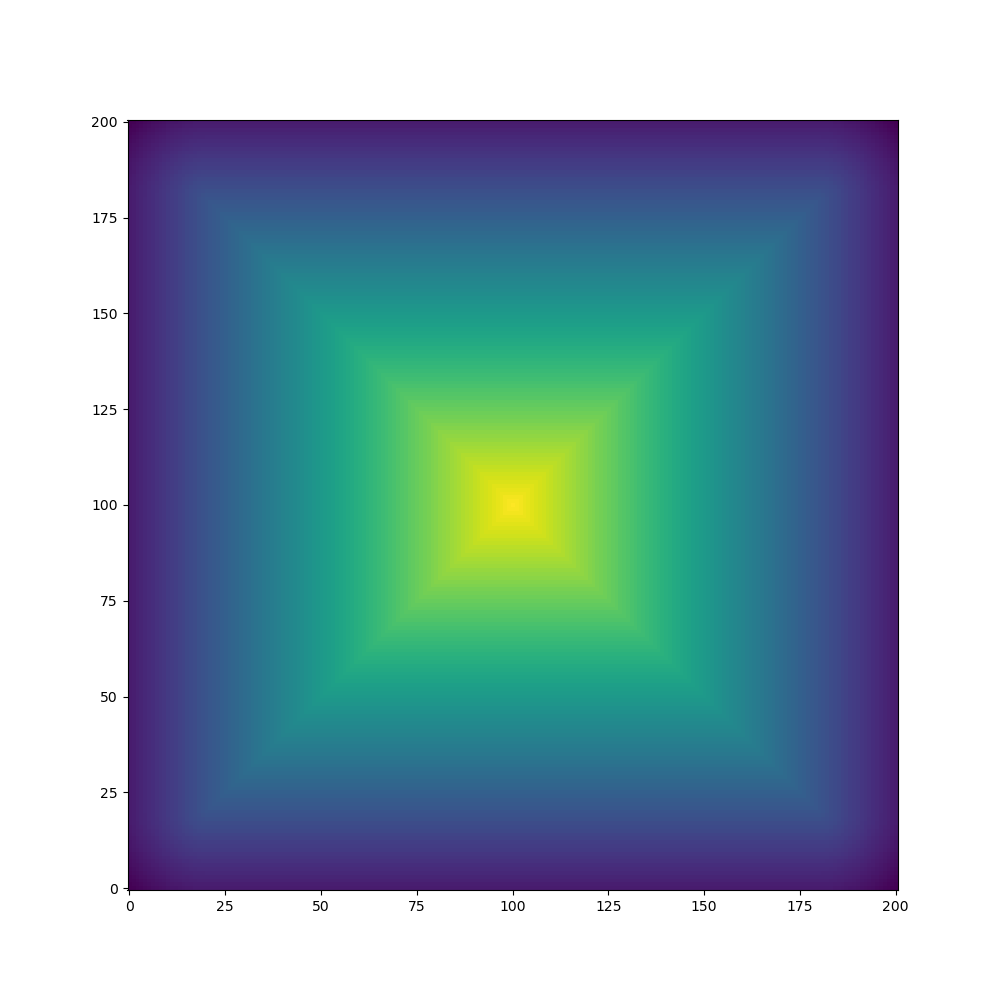

In [15]:
plt.figure(figsize=(10,10))
# plt.imshow((PressureSolver.buf.b).get().T, origin='lower')
# plt.imshow(imgs['lphi_prev'].get().T, origin='lower')
# rho = imgs['m'] / imgs['vol']
# plt.imshow(rho.get().T, origin='lower')
# plt.imshow(imgs['m'].get().T, origin='lower')
plt.imshow(solid_levelset.phi.get().T, origin='lower')
# plt.imshow(fluid_levelset.phi.get().T, origin='lower')
plt.show()

In [16]:
# particle.v[:,:] -= particle.x - cp.array([[0,2]])
# particle.v[particle.x[:,0]<0 ,0] = 1
# particle.v[particle.x[:,0]>=0 ,0] = -1

In [17]:
!nvidia-smi

Fri Oct 27 01:46:11 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.199.02   Driver Version: 470.199.02   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:01:00.0 Off |                  N/A |
| 59%   60C    P2   116W / 350W |  17485MiB / 24265MiB |      7%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA GeForce ...  Off  | 00000000:21:00.0 Off |                  N/A |
| 45%   

In [18]:
from tqdm.notebook import tqdm
import numpy as np
import os
import pickle
import torch
from torch.utils.dlpack import to_dlpack

particle_series = [particle.x.copy().astype(cp.float32).get()]

captured = False
imgs = []
MU=1000
iterations = 0
# for current_time in range(1):
current_time = 0.0
pbar = tqdm(total=DURATION)
grid_size=201
input_size=208
y_pad_l = int((input_size-grid_size)/2)
#vx_new,vy_new,vx,vy,dxdx,dydy,dxdy,dydx,sphi,lvol = np.zeros((208,208)),np.zeros((208,208)),np.zeros((208,208)), np.zeros((208,208)), np.zeros((208,208)), np.zeros((208,208)), np.zeros((208,208)), np.zeros((208,208)), np.zeros((208,208)), np.zeros((208,208))
vx_new,vy_new,vx,vy,dxdx,dydy,dxdy,dydx,sphi,lvol = cp.zeros((1,208,208)),cp.zeros((1,208,208)),cp.zeros((1,208,208)), cp.zeros((1,208,208)), cp.zeros((1,208,208)), cp.zeros((1,208,208)), cp.zeros((1,208,208)), cp.zeros((1,208,208)), cp.zeros((1,208,208)), cp.zeros((1,208,208))

device = 'cuda:0'

model = UNet(6).to(torch.device(device))
model.load_state_dict(torch.load(ckpt, map_location=device)['net'])
model.eval()
DURATION=7
while current_time < DURATION:
    ml_data= {}
    cfl_dt = GDX / max(1e-10, cp.max(cp.sum(particle.v ** 2, axis=-1) ** 0.5).item())
    #particle.v[:,0]=1
    #particle.v[:,1]=4
    current_dt = min(DT, cfl_dt, DURATION - current_time)
    
    current_time += current_dt
    pbar.update(current_dt)
    pbar.set_description(f"{current_dt = }")

    old_x = particle.x.copy()
    
    #center dist
    """
    particle.x += particle.v * current_dt
    particle.cp[:] = particle.x
    center_disp = particle.x - cp.array([[0,2]])
    center_dist = cp.sum(center_disp ** 2, axis=-1) ** 0.5
    new_x = (center_disp / center_dist[:,None] + cp.array([[0,2]]))
    # new_v = (new_x - old_x) / DT
    particle.cp[center_dist > 1,:] = new_x[center_dist > 1,:]
    # particle.v[center_dist > 1,:] = new_v[center_dist > 1,:]
    """
    particle.x += particle.v * current_dt

    sdf.project(rb_d, particle.x)
    particle.cp[:] = particle.x
    compute_fluid_levelset(particle, fluid_levelset, GDX)
    compute_fluid_volume(particle, fluid_volume, particle.vol)

    DensitySolver.solve(RHO, current_dt, particle.x, particle.m, particle.vol, grid.x.v, grid.y.v, solid_levelset.phi, solid_levelset.v, fluid_levelset.phi, fluid_volume.vol)
    
    particle.x[:] = particle.cp
    cuda.synchronize()
    #particle.v[:] = (particle.x - old_x) / current_dt

    img = {}
    img['wx'] = DensitySolver.wx.copy()
    img['wy'] = DensitySolver.wy.copy()
    # img['pen_pos'] = DensitySolver.pen_pos.copy()
    # img['pen_neg'] = DensitySolver.pen_neg.copy()
    img['m'] = DensitySolver.m.copy()
    img['vol'] = DensitySolver.vol.copy()
    img['b'] = DensitySolver.buf.b.copy()
    img['x'] = DensitySolver.x.copy()
    imgs.append(img)
        
    compute_fluid_levelset(particle, fluid_levelset, GDX)
    compute_fluid_volume(particle, fluid_volume, particle.vol)

    grid.x.m *= 0
    grid.x.v *= 0
    grid.y.m *= 0
    grid.y.v *= 0
    p2g(particle, grid)
    
    # p2g_phi = fluid_levelset.phi.get()

    grid.y.v += -10 * DT
    
    # bc_phi = fluid_levelset.phi.get()

    cuda.synchronize()
    if MU > 0:
        #print(MU)
        if solver == 'apic':
            """
            vx[y_pad_l:y_pad_l+grid_size:2,y_pad_l+1:y_pad_l+grid_size:2]=cp.asnumpy(grid.x.v.copy())
            vy[y_pad_l+1:y_pad_l+grid_size:2,y_pad_l:y_pad_l+grid_size:2]=cp.asnumpy(grid.y.v.copy())
            sphi[y_pad_l:y_pad_l+grid_size,y_pad_l:y_pad_l+grid_size]=cp.asnumpy(solid_levelset.phi.copy())
            lvol[y_pad_l:y_pad_l+grid_size,y_pad_l:y_pad_l+grid_size]=cp.asnumpy(fluid_volume.vol.copy())
            # dxdx at center
            dxdx[1:- 1, :] = vx[:-2, :] - vx[2:, :]
            dxdx[1:- 1, :][vx[:-2, :] == 0] = 0
            dxdx[1:- 1, :][vx[2:, :] == 0] = 0
            # dydy at center
            dydy[:, 1:-1] = vy[:, : -2] - vy[:, 2:]
            dydy[:, 1:-1][vy[:, :-2] ==0] = 0
            dydy[:, 1:-1][vy[:, 2:] ==0] = 0

            # dxdy at corner
            dxdy[:, 1: - 1] = vx[:, :-2] - vx[:, 2:]
            dxdy[:, 1: - 1][vx[:, :-2] == 0] = 0
            dxdy[:, 1: - 1][vx[:, 2:] == 0] = 0

            # dydx at corner
            dydx[1: -1, :] = vy[:-2, :] - vy[2:, :]
            dydx[1: -1, :][vy[:-2, :] == 0] = 0
            dydx[1: -1, :][vy[2:, :] == 0] = 0

            """
            ViscositySolver.solve(current_dt, MU, RHO, grid.x.v, grid.y.v, solid_levelset.phi, solid_levelset.v, fluid_levelset.phi, fluid_volume.vol)
            """
            vx_new[y_pad_l:y_pad_l+grid_size:2,y_pad_l+1:y_pad_l+grid_size:2]=cp.asnumpy(grid.x.v.copy())
            vy_new[y_pad_l+1:y_pad_l+grid_size:2,y_pad_l:y_pad_l+grid_size:2]=cp.asnumpy(grid.y.v.copy())
            """
        if solver =='unet':
            vx[0,y_pad_l:y_pad_l+grid_size:2,y_pad_l+1:y_pad_l+grid_size:2]=grid.x.v.copy()
            vy[0,y_pad_l+1:y_pad_l+grid_size:2,y_pad_l:y_pad_l+grid_size:2]=grid.y.v.copy()
            sphi[0,y_pad_l:y_pad_l+grid_size,y_pad_l:y_pad_l+grid_size]=solid_levelset.phi.copy()
            lvol[0,y_pad_l:y_pad_l+grid_size,y_pad_l:y_pad_l+grid_size]=fluid_volume.vol.copy()
            #vx[lvol==0]=0
            #vy[lvol==0]=0
            # dxdx at center
            dxdx[0,1:- 1, :] = vx[0,:-2, :] - vx[0,2:, :]
            dxdx[0,1:- 1, :][vx[0,:-2, :] == 0] = 0
            dxdx[0,1:- 1, :][vx[0,2:, :] == 0] = 0
            # dydy at center
            dydy[0,:, 1:-1] = vy[0,:, : -2] - vy[0,:, 2:]
            dydy[0,:, 1:-1][vy[0,:, :-2] ==0] = 0
            dydy[0,:, 1:-1][vy[0,:, 2:] ==0] = 0

            # dxdy at corner
            dxdy[0,:, 1: - 1] = vx[0,:, :-2] - vx[0,:, 2:]
            dxdy[0,:, 1: - 1][vx[0,:, :-2] == 0] = 0
            dxdy[0,:, 1: - 1][vx[0,:, 2:] == 0] = 0

            # dydx at corner
            dydx[0,1: -1, :] = vy[0,:-2, :] - vy[0,2:, :]
            dydx[0,1: -1, :][vy[0,:-2, :] == 0] = 0
            dydx[0,1: -1, :][vy[0,2:, :] == 0] = 0
            
            lvol =lvol/0.02/0.02
            sphi[sphi>0]=2
            sphi[sphi<=0]=1
            sphi[sphi==2]=0
            input = cp.concatenate([dxdx, dydy, dxdy, dydx, sphi, lvol], axis=0)
            #input = cp.concatenate([vx, vy, sphi, lvol], axis=0)

            input = cp.expand_dims(input, axis=0)
            input[cp.isnan(input)] = 0
            #print(input.shape)
            output = cp.from_dlpack(to_dlpack(model(torch.torch.as_tensor(input,dtype=torch.float32, device=f'cuda:0'))))*current_dt

            delvx = output[0,0,y_pad_l:y_pad_l+grid_size:2, y_pad_l+1:y_pad_l+grid_size:2]
            delvy = output[0,1,y_pad_l+1:y_pad_l+grid_size:2, y_pad_l:y_pad_l+grid_size:2]

            grid.x.v +=delvx
            grid.y.v +=delvy
            grid.x.v[grid.x.m==0]=0
            grid.y.v[grid.y.m==0]=0


        extrapolate(GRES, 3, grid.x.v, grid.y.v, grid.x.m, grid.y.m)

    cuda.synchronize()
    apply_boundary_condition(grid, solid_levelset, GDX)

    # visc_phi = fluid_levelset.phi.get()
    
    PressureSolver.solve(grid.x.v, grid.y.v, solid_levelset.phi, solid_levelset.v, fluid_levelset.phi, wx=DensitySolver.wx, wy=DensitySolver.wy)
    # PressureSolver.solve(grid.x.v, grid.y.v, solid_levelset.phi, solid_levelset.v, fluid_levelset.phi)

    g2p(particle, grid)
    
    iterations += 1
    if iterations % 1 == 0:
        particle_series.append(particle.x.copy().astype(cp.float32).get())
    """   
    ml_data['vx']=vx
    ml_data['vy']=vy
    ml_data['vx_new']=vx_new
    ml_data['vy_new']=vy_new
    ml_data['dxdx']=dxdx
    ml_data['dydy']=dydy
    ml_data['dxdy']=dxdy
    ml_data['dydx']=dydx
    ml_data['sphi']=sphi
    ml_data['lvol']=lvol
    ml_data['dt']=current_dt
    ml_data['mu']=MU
    path = f'../data/2D/drop'

    num_files = len([f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))])
    filename = path + f'/drop_{iterations}.pickle'
    """
    #with open(filename, 'wb') as f:
        #pickle.dump(ml_data, f)
with open('./fib4col_unet11.pickle', 'wb') as f:
    pickle.dump(particle_series, f)  

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/conda/lib/python3.9/site-packages/numba/cuda/dispatcher.py:539: NumbaPerformanceWarning: Grid size 7 will likely result in GPU under-utilization due to low occupancy.
  warn(NumbaPerformanceWarning(msg))
/opt/conda/lib/python3.9/site-packages/numba/cuda/dispatcher.py:539: NumbaPerformanceWarning: Grid size 7 will likely result in GPU under-utilization due to low occupancy.
  warn(NumbaPerformanceWarning(msg))
/opt/conda/lib/python3.9/site-packages/numba/cuda/dispatcher.py:539: NumbaPerformanceWarning: Grid size 2 will likely result in GPU under-utilization due to low occupancy.
  warn(NumbaPerformanceWarning(msg))
/opt/conda/lib/python3.9/site-packages/numba/cuda/dispatcher.py:539: NumbaPerformanceWarning: Grid size 49 will likely result in GPU under-utilization due to low occupancy.
  warn(NumbaPerformanceWarning(msg))
/opt/conda/lib/python3.9/site-packages/numba/cuda/dispatcher.py:539: NumbaPerformanceWarning: Grid size 16 will likely result in GPU under-utilization due to low o

In [19]:
# with open('./fib3_unet.pickle', 'wb') as f:
#     pickle.dump(particle_series, f)  

Animation size has reached 21003307 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


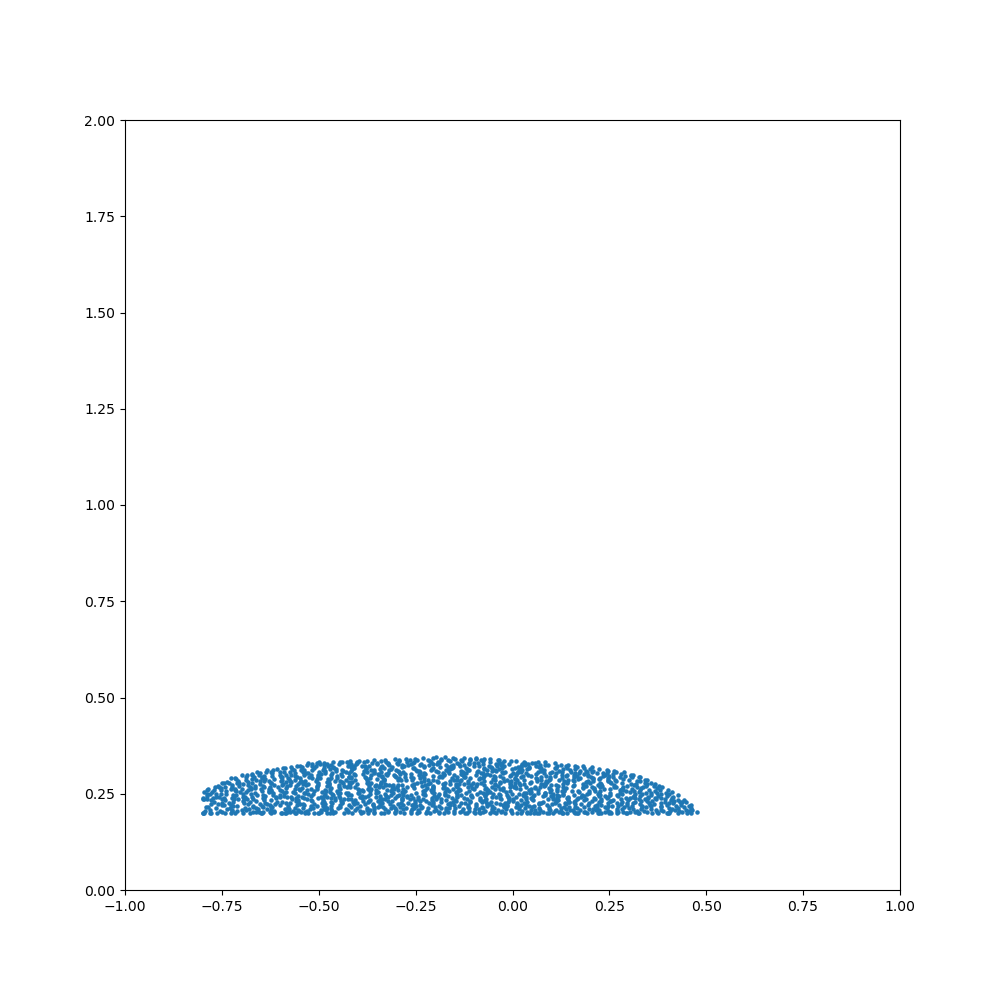

In [20]:
from matplotlib.animation import FuncAnimation

#with open('./fib3__unet.pickle', 'rb') as f:
    #particle_series= pickle.load(f)  
fig = plt.figure(figsize=(10,10))
points = plt.scatter(*(particle_series[0][:,d] for d in range(D)), s=5)
# vectors = plt.quiver(*(particle.x[:,d].get() for d in range(D)), *(v_after[:,d].get() for d in range(D)), color='#FF0000')
plt.xlim([BOUND_MIN[0], BOUND_MIN[0]+BOUND_SIZE[0]])
plt.ylim([BOUND_MIN[1], BOUND_MIN[1]+BOUND_SIZE[1]])

def update(frame):
    points.set_offsets(particle_series[frame])

ani = FuncAnimation(fig, update, frames=range(len(particle_series)), blit=True)

from IPython.display import HTML
HTML(ani.to_jshtml())

interactive(children=(BoundedIntText(value=0, continuous_update=True, description='x', max=2100), Output()), _…

interactive(children=(Dropdown(description='x', options=('wx', 'wy', 'm', 'vol', 'b', 'x'), value='wx'), Outpu…

interactive(children=(Dropdown(description='x', options=(0, 1), value=0), Output()), _dom_classes=('widget-int…

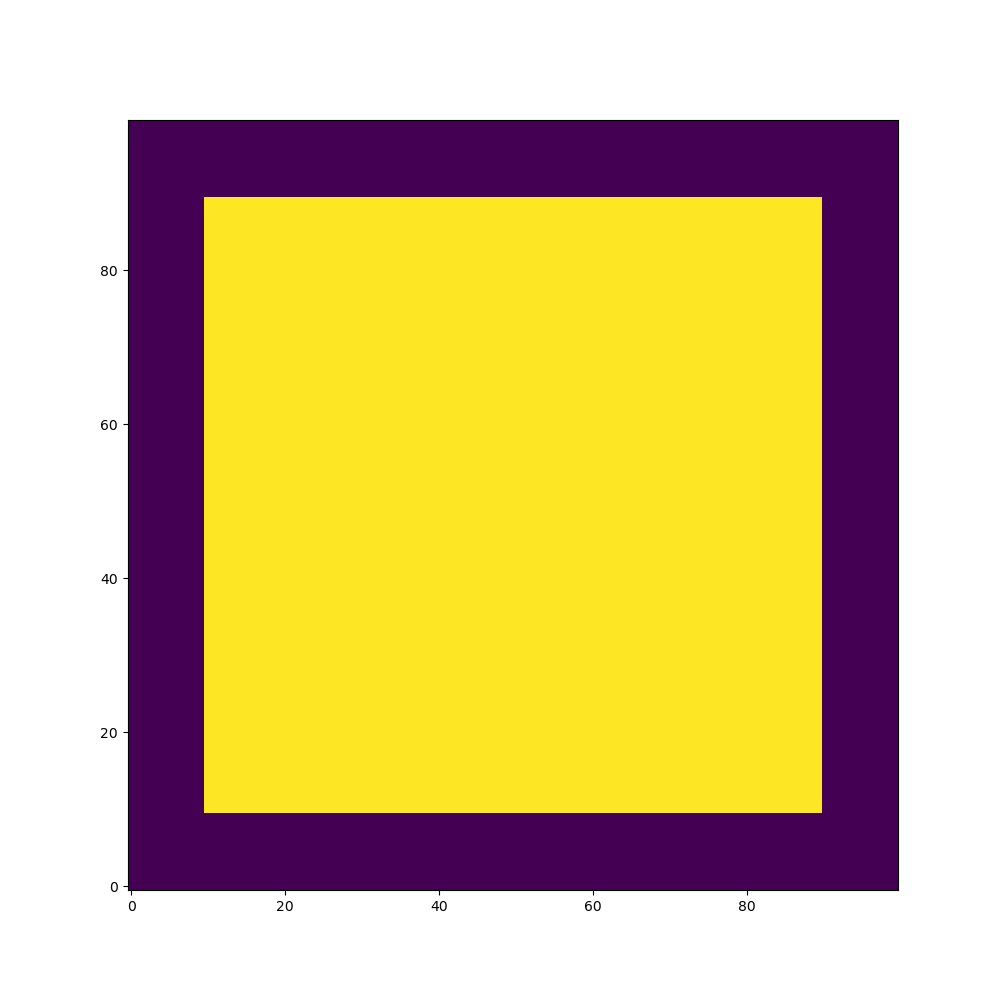

In [21]:
from matplotlib.animation import FuncAnimation

IMG_SLICE = 0
IMG_AXIS = 0
IMG_TARGET = 'b'


plt.figure(figsize=(10,10))
plt_img = plt.imshow(imgs[IMG_SLICE][IMG_TARGET].get().T, origin='lower')

import numpy as np

def change_img():
    img = imgs[IMG_SLICE][IMG_TARGET].get()
    if len(img.shape) > 2:
        img = img[:,:,IMG_AXIS]
    plt_img.set_data(img.T)
    plt_img.set_clim(np.min(img), np.max(img))

def change_slice(x):
    global IMG_SLICE
    IMG_SLICE = x
    change_img()
def change_target(x):
    global IMG_TARGET
    IMG_TARGET = x
    change_img()
def change_axis(x):
    global IMG_AXIS
    IMG_AXIS = x
    change_img()

import ipywidgets as widgets
slice_selector = widgets.BoundedIntText(
    value=0,
    min=0,
    max=len(imgs)-1,
    step=1,
    continuous_update=True,
)
widgets.interact(change_slice, x=slice_selector)
widgets.interact(change_target, x=list(imgs[0].keys()))
widgets.interact(change_axis, x=[0,1])
plt.show()

In [22]:
# plt.figure()
# # plt.imshow((PressureSolver.buf.b).get().T, origin='lower')
# # plt.imshow(imgs['lphi_prev'].get().T, origin='lower')
# # rho = imgs['m'] / imgs['vol']
# # plt.imshow(rho.get().T, origin='lower')
# # plt.imshow(imgs['m'].get().T, origin='lower')
# plt.imshow(imgs['b'].get().T, origin='lower')
# # plt.imshow(fluid_levelset.phi.get().T, origin='lower')
# plt.show()
# # grid_.x.v.T

In [23]:
# with open('./fib3unseen_apic.pickle', 'wb') as f:
    pickle.dump(particle_series, f)  

IndentationError: unexpected indent (2297496596.py, line 2)